In [96]:
#%% 
import numpy as np 
import soundfile as sf
from matplotlib import pyplot as plt
from IPython.display import display,Audio

def EchoKernel(Fs=44100,Delay=2,Decay=0.8):
    d = np.round(Delay*Fs).astype(int)
    ker = np.zeros((d+1,))
    ker[0] = 1
    ker[d] = Decay
    return ker

def isThereEcho(sig,Fs=44100,Delay=2):
    sig = sig.reshape(sig.shape[0],-1)
    len_sig, ch_sig = sig.shape
    nfft = int(2**np.ceil(np.log2(len_sig)))
    nfft2 = int(nfft/2)
    nfft4 = int(nfft/4)
    x = np.zeros((nfft,))

    d = np.round(Delay*Fs).astype(int) 

    v = np.zeros((ch_sig,))
    b = np.zeros((ch_sig,),bool)
    Cep = np.zeros((nfft,ch_sig))
    for ich in range(ch_sig):
        x[:len_sig] = sig[:,ich]
        X = np.fft.fft(x)
        X0 = X[:nfft2+1]/(nfft2)
        Mag0 = np.abs(X0)
        Phase0 = np.angle(X0)
        Mag = np.concatenate([Mag0, np.flipud(Mag0[1:nfft2])])
        Phase = np.concatenate([Phase0, -np.flipud(Phase0[1:nfft2])])
        lnX = np.log(Mag)+1j*Phase
        Cep[:,ich] = np.real(np.fft.ifft(lnX))
        c = Cep[d,ich] # dでのケプストラムを記録
        mu = np.mean(Cep[3:nfft4,ich])
        std = np.std(Cep[3:nfft4,ich])
        z = (c-mu)/std 
        v[ich] = z     # dでのケプストラムのz値 
        b[ich] = (z>2) # dでのケプストラムが平均+SDより大きいなら（明らかなピークなら1カウントアップ）
    return b, v, Cep[:nfft4,:]

def SpreadEchoKernel(Fs=44100,Delay=2,Decay=0.8,KeySeed=210831):
    np.random.seed(KeySeed)
    LenPN=1023
    pn = 2*np.random.random((LenPN,))-np.ones((LenPN,))
    d = np.round(Delay*Fs).astype(int)
    ker = np.zeros((d+LenPN,))
    ker[0] = 1
    ker[d:d+LenPN] = pn*Decay
    return ker

def isThereSpreadEcho(sig,Fs=44100,Delay=2,KeySeed=210831):
    np.random.seed(KeySeed)
    LenPN=1023
    pn = 2*np.random.random((LenPN,))-np.ones((LenPN,))
    sig = sig.reshape(sig.shape[0],-1)
    len_sig, ch_sig = sig.shape
    nfft = int(2**np.ceil(np.log2(len_sig)))
    nfft2 = int(nfft/2)
    nfft4 = int(nfft/4)
    x = np.zeros((nfft,))

    d = np.round(Delay*Fs).astype(int) 

    v = np.zeros((ch_sig,))
    b = np.zeros((ch_sig,),bool)
    AutoCep = np.zeros((nfft4,ch_sig))
    for ich in range(ch_sig):
        x[:len_sig] = sig[:,ich]
        X = np.fft.fft(x)
        X0 = X[:nfft2+1]/(nfft2)
        Mag0 = np.abs(X0)
        Phase0 = np.angle(X0)
        Mag = np.concatenate([Mag0, np.flipud(Mag0[1:nfft2])])
        Phase = np.concatenate([Phase0, -np.flipud(Phase0[1:nfft2])])
        lnX = np.log(Mag)+1j*Phase
        Cep = np.real(np.fft.ifft(lnX))
        corr = np.correlate(Cep[:nfft4],pn,"full")
        AutoCep[:,ich] = corr[len(pn)-1:]
        c = AutoCep[d,ich] # dでのケプストラムを記録
        mu = np.mean(AutoCep[3:nfft4,ich])
        std = np.std(AutoCep[3:nfft4,ich])
        z = (c-mu)/std 
        v[ich] = z     # dでのケプストラムのz値 
        b[ich] = (z>2) # dでのケプストラムが平均+SDより大きいなら（明らかなピークなら1カウントアップ）
    return b, v, AutoCep[:nfft4,:]

 
def AddNoise(sig,SNR=36):
    pow_sig = sig.dot(sig)/len(sig)
    pow_noise = pow_sig/(10**(SNR/10))
    noise = 2*np.random.random(sig.shape)-np.ones(sig.shape)
    noise = noise*np.sqrt(pow_noise)
    return sig+noise    



In [50]:
#%% エコーを加える前の音
WAV_HOST = 'wmtest.wav'
WAV_STEG = 'steg.wav'
WAV_REC = 'rec.wav'

Audio(WAV_HOST)

/var/folders/qq/y0p5l6xd5qb7l_6_x0nmwhv40000gn/T/ipykernel_40236/1193031421.py:21: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig1.show()


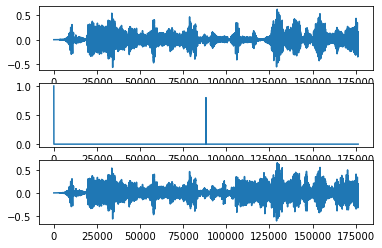

In [66]:
#%% エコーを加えた音を作る
Delay = 2 # Echo Delay in [s]
Decay = 0.8 # Echo Decay Ratio relative to Source


host, host_fs = sf.read(WAV_HOST)

ker1 = EchoKernel(host_fs,Delay=Delay,Decay=Decay)

steg = np.convolve(host,ker1)

fig1 = plt.figure()
ax11 = fig1.add_subplot(3,1,1)
ax11.plot(host[:2*len(ker1)])
ax12 = fig1.add_subplot(3,1,2)
ker10 = np.zeros((2*len(ker1),))
ker10[:len(ker1)]=ker1
ax12.plot(ker10)
ax13 = fig1.add_subplot(3,1,3)
ax13.plot(steg[:2*len(ker1)])
fig1.show()

sf.write(WAV_STEG,steg,host_fs)

Audio(WAV_STEG)



[ True] [303.88762824]


/var/folders/qq/y0p5l6xd5qb7l_6_x0nmwhv40000gn/T/ipykernel_40236/3227633108.py:14: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig2.show()


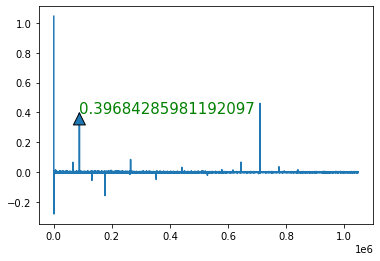

In [54]:
#%% エコーを検知する
rec, rec_fs = sf.read(WAV_STEG)

b, v, Cep = isThereEcho(rec,Fs=rec_fs,Delay=Delay)

print(b,v)

fig2 = plt.figure()
ax21 = fig2.add_subplot(1,1,1)

dt = int(np.round(Delay*rec_fs))
ax21.plot(Cep[1:,0])
ax21.annotate(str(Cep[dt,0]),xy=(dt,Cep[dt,0]),size=15,color="green",arrowprops=dict())
fig2.show()



[ True] [37.25604157]


/var/folders/qq/y0p5l6xd5qb7l_6_x0nmwhv40000gn/T/ipykernel_40236/2475502435.py:19: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig3.show()


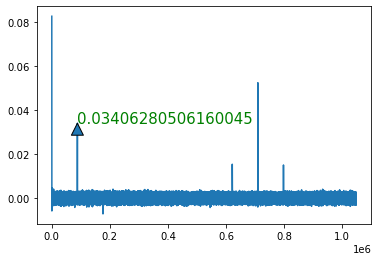

In [55]:
#%% 雑音化でもエコーを検知できるか？

steg, steg_fs = sf.read(WAV_STEG)
steg_n = AddNoise(steg,SNR=0)
sf.write(WAV_REC,steg_n,steg_fs)
Audio(WAV_REC)
rec, rec_fs = sf.read(WAV_REC)

b, v, Cep = isThereEcho(rec,Fs=rec_fs,Delay=Delay)

print(b,v)

fig3 = plt.figure()
ax31 = fig3.add_subplot(1,1,1)

dt = int(np.round(Delay*rec_fs))
ax31.plot(Cep[1:,0])
ax31.annotate(str(Cep[dt,0]),xy=(dt,Cep[dt,0]),size=15,color="green",arrowprops=dict())
fig3.show()



/var/folders/qq/y0p5l6xd5qb7l_6_x0nmwhv40000gn/T/ipykernel_40236/668223906.py:17: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig3.show()


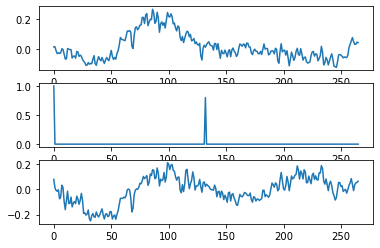

In [72]:
#%% Delayを短くしても検知できるか？
Delay = 0.003

ker1 = EchoKernel(host_fs,Delay=Delay,Decay=Decay)

steg = np.convolve(host,ker1)

fig3 = plt.figure()
ax31 = fig3.add_subplot(3,1,1)
ax31.plot(host[host_fs:host_fs+2*len(ker1)])
ax32 = fig3.add_subplot(3,1,2)
ker10 = np.zeros((2*len(ker1),))
ker10[:len(ker1)]=ker1
ax32.plot(ker10)
ax33 = fig3.add_subplot(3,1,3)
ax33.plot(steg[host_fs:host_fs+2*len(ker1)])
fig3.show()

sf.write(WAV_STEG,steg,host_fs)
Audio(WAV_STEG)






[ True] [300.23640777]


/var/folders/qq/y0p5l6xd5qb7l_6_x0nmwhv40000gn/T/ipykernel_40236/902241996.py:14: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig4.show()


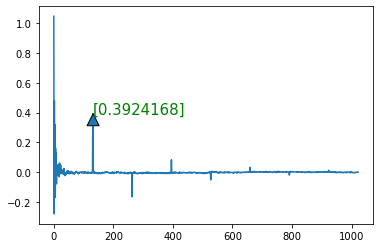

In [62]:
rec, rec_fs = sf.read(WAV_STEG)

b, v, Cep = isThereEcho(rec,Fs=rec_fs,Delay=Delay)
print(b,v)

fig4 = plt.figure()
ax41 = fig4.add_subplot(1,1,1)

nfft4 = int(len(Cep)/4)
dt = int(np.round(Delay*rec_fs))
#ax41.plot(Cep[1:int(nfft4+1),0])
ax41.plot(Cep[1:1024,0])
ax41.annotate(str(Cep[dt]),xy=(dt,Cep[dt]),size=15,color="green",arrowprops=dict())
fig4.show()

In [63]:
#%% エコーを検出するフレーム長を短くしても検知できるか？　
FrameLength = 0.5 # in [s]
step = int(np.ceil(FrameLength*rec_fs))
len_rec = len(rec)
num_frame = int(np.floor(len_rec/step))
v = np.zeros((num_frame,))
b = np.zeros((num_frame,))
for k in range(num_frame):
    s = k*step
    e = (k+1)*step
    b[k],v[k],Cep = isThereEcho(rec[s:e],Fs=rec_fs,Delay=Delay) 
print(b)



[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]


/var/folders/qq/y0p5l6xd5qb7l_6_x0nmwhv40000gn/T/ipykernel_40236/1878729269.py:35: RuntimeWarning: divide by zero encountered in log
  lnX = np.log(Mag)+1j*Phase
/Users/kotaro/.pyenv/versions/miniforge3-4.10.1-5/lib/python3.9/site-packages/numpy/core/_methods.py:179: RuntimeWarning: invalid value encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/Users/kotaro/.pyenv/versions/miniforge3-4.10.1-5/lib/python3.9/site-packages/numpy/core/_methods.py:212: RuntimeWarning: invalid value encountered in reduce
  arrmean = umr_sum(arr, axis, dtype, keepdims=True, where=where)


In [64]:
#%% フレームごとにDelayを変える。bit0を表すDelay0と、bit1を表すDelay1
Delay0 = 0.003
Delay1 = 0.0035
FrameLength = 0.5
# encbits = ['1','0','0'] 
encbits = list('{:0b}'.format(ord('A'))) 
print(encbits)
# encbits = ''+encbits

frame_host = int(np.ceil(FrameLength*host_fs))
len_host = len(host)
num_frame_host = int(np.floor(len_host/frame_host))

ker0 = EchoKernel(Fs=host_fs,Delay=Delay0)
ker1 = EchoKernel(Fs=host_fs,Delay=Delay1)

steg = []
for k in range(num_frame_host):
    s = k*frame_host
    e = (k+1)*frame_host
    x = host[s:e]
    kk = k%(len(encbits))
    if encbits[kk] == '0':
        y = np.convolve(x,ker0)
    elif encbits[kk] == '1':
        y = np.convolve(x,ker1)
    else:
        y = x
    steg = np.concatenate([steg,y])

sf.write(WAV_STEG,steg,host_fs)

Audio(WAV_STEG)





['1', '0', '0', '0', '0', '0', '1']


In [65]:
rec, rec_fs = sf.read(WAV_STEG)

frame_rec = int(np.ceil(FrameLength*rec_fs))
len_rec = len(rec)
num_frame = int(np.floor(len_rec/frame_rec))
v = np.zeros((num_frame,))
b = np.zeros((num_frame,))
for k in range(num_frame):
    s = k*frame_rec
    e = (k+1)*frame_rec
    b0,v0,Cep = isThereEcho(rec[s:e],Fs=rec_fs,Delay=Delay0)    
    b1,v1,Cep = isThereEcho(rec[s:e],Fs=rec_fs,Delay=Delay1)
    if b0==True:
        if b1==True:
            if v0>v1:
                b[k]=0
            else:
                b[k]=1
        else:
            b[k]=0
    else:
        if b1==True:
            b[k]=1
        else:
            b[k]= -1
nrep = num_frame//7
print(b[:nrep*7].reshape(-1,7))

[[1. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 1.]
 [1. 1. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 1.]
 [1. 1. 0. 0. 0. 0. 0.]
 [1. 1. 0. 0. 0. 0. 0.]
 [1. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 1.]]


/var/folders/qq/y0p5l6xd5qb7l_6_x0nmwhv40000gn/T/ipykernel_40236/2838923104.py:21: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig1.show()


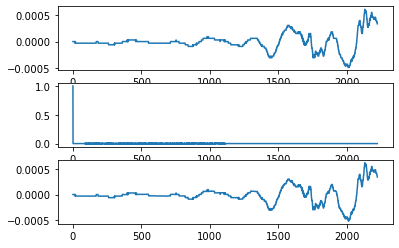

In [98]:
#%% エコーを加えた音を作る
Delay = 0.002 # Echo Delay in [s]
Decay = 0.01 # Echo Decay Ratio relative to Source


host, host_fs = sf.read(WAV_HOST)

ker1 = SpreadEchoKernel(host_fs,Delay=Delay,Decay=Decay)

steg = np.convolve(host,ker1)

fig1 = plt.figure()
ax11 = fig1.add_subplot(3,1,1)
ax11.plot(host[:2*len(ker1)])
ax12 = fig1.add_subplot(3,1,2)
ker10 = np.zeros((2*len(ker1),))
ker10[:len(ker1)]=ker1
ax12.plot(ker10)
ax13 = fig1.add_subplot(3,1,3)
ax13.plot(steg[:2*len(ker1)])
fig1.show()

sf.write(WAV_STEG,steg,host_fs)

Audio(WAV_STEG)

[ True] [89.24751715]


/var/folders/qq/y0p5l6xd5qb7l_6_x0nmwhv40000gn/T/ipykernel_40236/1216711018.py:14: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig2.show()


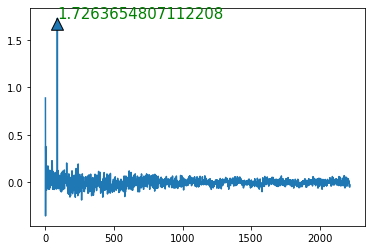

In [99]:
#%% エコーを検知する
rec, rec_fs = sf.read(WAV_STEG)

b, v, AutoCep = isThereSpreadEcho(rec,Fs=rec_fs,Delay=Delay)

print(b,v)

fig2 = plt.figure()
ax21 = fig2.add_subplot(1,1,1)

dt = int(np.round(Delay*rec_fs))
ax21.plot(AutoCep[1:2*len(ker1),0])
ax21.annotate(str(AutoCep[dt,0]),xy=(dt,AutoCep[dt,0]),size=15,color="green",arrowprops=dict())
fig2.show()